In [1]:
from __future__ import division, print_function, absolute_import

import os
import numpy as np
import pandas as pd
import cv2
import pickle
import imutils
from scipy import misc
import h5py
import tensorflow as tf
 

assessor_image_path = '/Users/sam/All-Program/App-DataSet/HouseClassification/data_models/assessor_images/batch_data'
g_aerial_image_path = '/Users/sam/All-Program/App-DataSet/HouseClassification/data_models/aerial_images/google/batch_data'
g_overlayed_image_path = '/Users/sam/All-Program/App-DataSet/HouseClassification/data_models/overlayed_images/google/batch_data'

assessor_meta_path = '/Users/sam/All-Program/App-DataSet/HouseClassification/statistics/assessor_images/cv_train_pins_info.csv'
aerial_meta_path = '/Users/sam/All-Program/App-DataSet/HouseClassification/statistics/aerial_images/cv_train_pins_info.csv'
g_overlayed_meta_path = '/Users/sam/All-Program/App-DataSet/HouseClassification/statistics/overlayed_images/cv_train_pins_info.csv'

label_dict = {'0': 'land', '1': 'house'}
batch_num = 4

## READ PICKLE FILE

In [2]:
def getPickleFile(folderPath, picklefileName):
    path_from = os.path.join(folderPath, picklefileName)

    with open(path_from, "rb") as p:
        data = pickle.load(p)
        dataX = data['dataX']
        dataY = data['dataY']
        labelDict = data['labelDict']
    return dataX, dataY, labelDict

def getH5File(folderPath, fileName):
    path_from = os.path.join(folderPath, fileName + '.h5')
    
    hf = h5py.File(path_from, 'r')
    dataX = np.array(hf.get('dataX'), dtype='float32')
    dataY = np.array(hf.get('dataY'), dtype='float32')
    hf.close()

    return dataX, dataY

## GET THE IMAGES

In [3]:
assessorX, assessorY = getH5File(folderPath=assessor_image_path, fileName='train_%s'%str(batch_num))
print (assessorX.shape, assessorY.shape)

(128, 260, 260, 3) (128,)


In [4]:
aerialX, aerialY = getH5File(folderPath=g_aerial_image_path, fileName='train_%s'%str(batch_num))
print (aerialX.shape, aerialY.shape)

(128, 400, 400, 3) (128,)


In [5]:
overlayedX, overlayedY = getH5File(folderPath=g_overlayed_image_path, fileName='train_%s'%str(batch_num))
print (overlayedX.shape, overlayedY.shape)

(128, 400, 400, 3) (128,)


## GET THE META FILE

In [6]:
assessor_pin_batch_row_meta = pd.read_csv(assessor_meta_path, header='infer')
print (assessor_pin_batch_row_meta.shape)
assessor_pin_batch_row_meta.head(2)

(1726, 3)


,property_pins,property_type,dataset_type
0,21-31-209-007-0000,land,cvalid
1,20-04-222-037-0000,land,cvalid


In [7]:
aerial_pin_batch_row_meta = pd.read_csv(aerial_meta_path, header='infer')
print (aerial_pin_batch_row_meta.shape)
aerial_pin_batch_row_meta.head(2)

(1726, 3)


,property_pins,property_type,dataset_type
0,21-31-209-007-0000,land,cvalid
1,20-04-222-037-0000,land,cvalid


In [8]:
overlayed_pin_batch_row_meta = pd.read_csv(g_overlayed_meta_path, header='infer')
print (overlayed_pin_batch_row_meta.shape)
overlayed_pin_batch_row_meta.head()

(1726, 3)


,property_pins,property_type,dataset_type
0,21-31-209-007-0000,land,cvalid
1,20-04-222-037-0000,land,cvalid
2,16-03-100-033-0000,land,cvalid
3,20-26-423-014-0000,land,cvalid
4,20-06-402-017-0000,land,cvalid


## VISUALIZATION

In [9]:
import matplotlib.pyplot as plt
%matplotlib inline
def vizualize(imageArray, title_arr, data_type, rows, columns, figsize=(40, 6)):
    fig1, axs = plt.subplots(rows,columns, figsize=figsize, facecolor='y', edgecolor='k')
    if columns>1:
        axs = axs.ravel()
    for no, (image, title) in enumerate(zip(imageArray, title_arr)):
        axs[no].imshow(np.array(image, dtype=data_type))
        axs[no].set_title(title)

In [10]:
# row_id_prop_pin_map = pd.read_csv(row_id_prop_pin_map_path)
# print (row_id_prop_pin_map.shape)
# row_id_prop_pin_map.head()

### The image name in the directory is the combination of row_id and pin. So take a random row_id, combine it with pin and get the image from disk

In [11]:
# row_ids = [7, 10, 20, 25, 84, 167, 260, 261, 275, 280, 290, 291, 299] # A random row_id
# pins = row_id_prop_pin_map[row_id_prop_pin_map['row_id'].isin(row_ids)]['pin'].values
# image_id = [str(p)+'_'+str(r) for r, p in zip(row_ids, pins)]
# print (image_id)
# image_path_arr = [os.path.join(image_data_path, im_id+'.jpg') for im_id in image_id]
# image_path_arr = [image_path for image_path in image_path_arr if os.path.exists(image_path)]
# print(image_path_arr)

## READ THE IMAGE

In [28]:

gaussian_blurr = [5,5,0] 
# filter_shapeX, filter_sahpe2, noise_sigma, Blurr 17,17 was very high to be detected by Canny Edge Detection
# 
canny_edge = [50,150]

def sobel_edge(img):
    sobelX= cv2.Sobel(img, cv2.CV_64F,1,0)
    sobelY= cv2.Sobel(img, cv2.CV_64F,0,1)
    sobelX = np.uint8(np.absolute(sobelX))#np.absolute(sobelX)
    sobelY = np.uint8(np.absolute(sobelY))#np.absolute(sobelY)
    sobelCombined = cv2.bitwise_or(sobelX, sobelY)
    return sobelCombined



def image_transform(image_ndarray):

    image_arr = []
    image_gray_arr = []
    image_blurr_arr = []
    image_sobel_edge_arr = []
    image_canny_edge_arr = []
    
    for img in image_ndarray:
#         image = cv2.imread(image_path)
        
        if type(img).__module__ == 'numpy':    
            image = misc.imresize(img, [224,224])
#             image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
#             image_blurr = cv2.GaussianBlur(image_gray, (gaussian_blurr[0], gaussian_blurr[1]), gaussian_blurr[2]) 
#             image_sobel_edge = sobel_edge(image_blurr)

#             image_canny_edge = imutils.auto_canny(image_blurr)
#             #cv2.Canny(image_blurr,canny_edge[0],canny_edge[1],apertureSize = 3)

            image_arr.append(image)
#             image_gray_arr.append(image_gray)
#             image_blurr_arr.append(image_blurr)
#             image_sobel_edge_arr.append(image_sobel_edge)
#             image_canny_edge_arr.append(image_canny_edge)

    return image_arr#, image_gray_arr, image_blurr_arr, image_sobel_edge_arr, image_canny_edge_arr

def zero_pad(inp, crop_img_shape, out_shape):
    '''
    :param inp:
    :param out_shape:
    :return:

    One image at a time
    '''
    m, n, c = crop_img_shape#inp.get_shape().as_list()
    out_m, out_n, out_c = out_shape

    to_pad_m = max(out_m - m, 0)
    to_pad_n = max(out_n - n, 0)
    to_pad_c = max(out_c - c, 0)
    
    pad_m1 = to_pad_m // 2
    pad_m2 = to_pad_m - pad_m1
    
    pad_n1 = to_pad_n // 2
    pad_n2 = to_pad_n - pad_n1
    
    pad_c1 = to_pad_c // 2
    pad_c2 = to_pad_c - pad_c1
    
    paddings = tf.constant([[pad_m1, pad_m2], [pad_n1, pad_n2], [pad_c1, pad_c2]])
    inp = tf.pad(inp, paddings, 'CONSTANT')
    return inp

def crop_and_pad(inp_img_shape, crop_img_shape, out_img_shape):
    imgIN = tf.placeholder(dtype=tf.float32, shape=inp_img_shape)
    if len(crop_img_shape) != 0:
        imageOUT = tf.image.central_crop(imgIN, crop_img_shape[0]/inp_img_shape[0])
    else:
        imageOUT = imgIN
        crop_img_shape = inp_img_shape
    imageOUT1 = zero_pad(imageOUT, crop_img_shape, out_img_shape)
    return imgIN, imageOUT1

### HOG DESCRIPTOR

In [13]:
from skimage import feature

def hog_descriptor(img, feature_params):
    orientations = feature_params['orientations']
    pixels_per_cell = feature_params['pixels_per_cell']
    cells_per_block = feature_params['cells_per_block']
    vizualize = feature_params['vizualize']
    transform_sqrt = feature_params['transform_sqrt']
    
    hist, hog = feature.hog(img, orientations=orientations, pixels_per_cell=pixels_per_cell,
                            cells_per_block=cells_per_block, visualise=vizualize, 
                            transform_sqrt=transform_sqrt)
    return hist, hog

def hog_feature(image_arr, feature_params):
    hist_arr = []
    hog_feature_arr = []
    for no,img in enumerate(image_arr):
#         print (img.shape)
        hist, hog_image = hog_descriptor(img, feature_params)
        hist_arr.append(hist)
        hog_feature_arr.append(hog_image)
    return hist_arr, hog_feature_arr


## SELECT A BATCH AND SOME RANDOM PICTURES:

In [14]:
strt = 20
end = 68

In [15]:
rand_assessorX = assessorX[strt:end, :]
randomY = assessorY[strt:end]
rand_assessorY = [label_dict[str(int(i))] for i in randomY]
assessor_pin = np.array(assessor_pin_batch_row_meta[assessor_pin_batch_row_meta['dataset_type']=='batch_%s'%str(batch_num-1)]['property_pins'], dtype=str)[strt:end]

assessor_img_arr = image_transform(rand_assessorX)
print (rand_assessorX.shape)
print (rand_assessorY)
print (assessor_pin)

(48, 260, 260, 3)
['house', 'land', 'house', 'land', 'house', 'house', 'land', 'house', 'house', 'house', 'land', 'house', 'land', 'house', 'land', 'land', 'house', 'house', 'house', 'house', 'house', 'land', 'house', 'house', 'house', 'house', 'land', 'land', 'house', 'land', 'land', 'house', 'land', 'land', 'land', 'land', 'land', 'land', 'house', 'land', 'land', 'land', 'house', 'land', 'land', 'land', 'house', 'house']
['16-09-422-028-0000' '20-16-200-015-0000' '16-15-132-013-0000'
 '20-08-213-042-0000' '20-30-216-024-0000' '21-31-301-016-0000'
 '25-24-410-037-0000' '20-18-215-037-0000' '20-18-425-028-0000'
 '20-18-412-014-0000' '14-32-407-081-0000' '20-08-316-019-0000'
 '20-21-300-042-0000' '16-02-110-011-0000' '20-18-406-046-0000'
 '20-18-116-014-0000' '14-29-313-019-0000' '16-15-224-026-0000'
 '16-15-107-026-0000' '16-15-111-029-0000' '20-07-412-012-0000'
 '20-23-402-009-0000' '16-11-409-004-0000' '20-18-222-029-0000'
 '20-16-314-028-0000' '20-08-303-009-0000' '25-24-104-001-000

In [16]:
rand_aerialX = aerialX[strt:end, :]
randomY = aerialY[strt:end]
rand_aerialY = [label_dict[str(int(i))] for i in randomY]
aerial_pin = np.array(aerial_pin_batch_row_meta[aerial_pin_batch_row_meta['dataset_type']=='batch_%s'%str(batch_num-1)]['property_pins'], dtype=str)[strt:end]

aerial_img_arr = image_transform(rand_aerialX)
print (rand_aerialX.shape)
print (rand_aerialY)
print (aerial_pin)

(48, 400, 400, 3)
['house', 'land', 'house', 'land', 'house', 'house', 'land', 'house', 'house', 'house', 'land', 'house', 'land', 'house', 'land', 'land', 'house', 'house', 'house', 'house', 'house', 'land', 'house', 'house', 'house', 'house', 'land', 'land', 'house', 'land', 'land', 'house', 'land', 'land', 'land', 'land', 'land', 'land', 'house', 'land', 'land', 'land', 'house', 'land', 'land', 'land', 'house', 'house']
['16-09-422-028-0000' '20-16-200-015-0000' '16-15-132-013-0000'
 '20-08-213-042-0000' '20-30-216-024-0000' '21-31-301-016-0000'
 '25-24-410-037-0000' '20-18-215-037-0000' '20-18-425-028-0000'
 '20-18-412-014-0000' '14-32-407-081-0000' '20-08-316-019-0000'
 '20-21-300-042-0000' '16-02-110-011-0000' '20-18-406-046-0000'
 '20-18-116-014-0000' '14-29-313-019-0000' '16-15-224-026-0000'
 '16-15-107-026-0000' '16-15-111-029-0000' '20-07-412-012-0000'
 '20-23-402-009-0000' '16-11-409-004-0000' '20-18-222-029-0000'
 '20-16-314-028-0000' '20-08-303-009-0000' '25-24-104-001-000

In [17]:
rand_overlayedX = overlayedX[strt:end, :]
randomY = overlayedY[strt:end]
rand_overlayedY = [label_dict[str(int(i))] for i in randomY]
overlayed_pin = np.array(overlayed_pin_batch_row_meta[overlayed_pin_batch_row_meta['dataset_type']=='batch_%s'%str(batch_num-1)]['property_pins'], dtype=str)[strt:end]

overlayed_img_arr = image_transform(rand_overlayedX)
print (rand_overlayedX.shape)
print (rand_overlayedY)
print (overlayed_pin)

(48, 400, 400, 3)
['house', 'land', 'house', 'land', 'house', 'house', 'land', 'house', 'house', 'house', 'land', 'house', 'land', 'house', 'land', 'land', 'house', 'house', 'house', 'house', 'house', 'land', 'house', 'house', 'house', 'house', 'land', 'land', 'house', 'land', 'land', 'house', 'land', 'land', 'land', 'land', 'land', 'land', 'house', 'land', 'land', 'land', 'house', 'land', 'land', 'land', 'house', 'house']
['16-09-422-028-0000' '20-16-200-015-0000' '16-15-132-013-0000'
 '20-08-213-042-0000' '20-30-216-024-0000' '21-31-301-016-0000'
 '25-24-410-037-0000' '20-18-215-037-0000' '20-18-425-028-0000'
 '20-18-412-014-0000' '14-32-407-081-0000' '20-08-316-019-0000'
 '20-21-300-042-0000' '16-02-110-011-0000' '20-18-406-046-0000'
 '20-18-116-014-0000' '14-29-313-019-0000' '16-15-224-026-0000'
 '16-15-107-026-0000' '16-15-111-029-0000' '20-07-412-012-0000'
 '20-23-402-009-0000' '16-11-409-004-0000' '20-18-222-029-0000'
 '20-16-314-028-0000' '20-08-303-009-0000' '25-24-104-001-000

## IMAGES

#### Assessor Images

48 ['16-09-422-028-0000-house', '20-16-200-015-0000-land', '16-15-132-013-0000-house', '20-08-213-042-0000-land', '20-30-216-024-0000-house', '21-31-301-016-0000-house', '25-24-410-037-0000-land', '20-18-215-037-0000-house', '20-18-425-028-0000-house', '20-18-412-014-0000-house', '14-32-407-081-0000-land', '20-08-316-019-0000-house', '20-21-300-042-0000-land', '16-02-110-011-0000-house', '20-18-406-046-0000-land', '20-18-116-014-0000-land', '14-29-313-019-0000-house', '16-15-224-026-0000-house', '16-15-107-026-0000-house', '16-15-111-029-0000-house', '20-07-412-012-0000-house', '20-23-402-009-0000-land', '16-11-409-004-0000-house', '20-18-222-029-0000-house', '20-16-314-028-0000-house', '20-08-303-009-0000-house', '25-24-104-001-0000-land', '16-14-402-048-0000-land', '20-18-104-024-0000-house', '20-08-430-003-0000-land', '20-17-226-018-0000-land', '16-14-403-036-0000-house', '20-07-227-049-0000-land', '16-09-315-093-1006-land', '25-09-421-005-0000-land', '20-08-403-013-0000-land', '20-

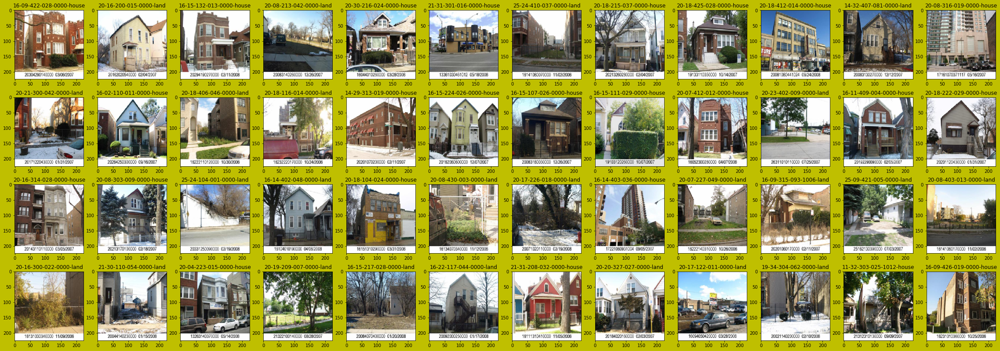

In [31]:
pin_ind = [str(p)+"-"+str(y) for p,y in zip(assessor_pin, rand_assessorY)]
print (len(assessor_pin), pin_ind)
vizualize(assessor_img_arr, pin_ind, data_type='uint8', rows=4, columns=12, figsize=(40, 14))

#### Aerial Images

48 ['16-09-422-028-0000-house', '20-16-200-015-0000-land', '16-15-132-013-0000-house', '20-08-213-042-0000-land', '20-30-216-024-0000-house', '21-31-301-016-0000-house', '25-24-410-037-0000-land', '20-18-215-037-0000-house', '20-18-425-028-0000-house', '20-18-412-014-0000-house', '14-32-407-081-0000-land', '20-08-316-019-0000-house', '20-21-300-042-0000-land', '16-02-110-011-0000-house', '20-18-406-046-0000-land', '20-18-116-014-0000-land', '14-29-313-019-0000-house', '16-15-224-026-0000-house', '16-15-107-026-0000-house', '16-15-111-029-0000-house', '20-07-412-012-0000-house', '20-23-402-009-0000-land', '16-11-409-004-0000-house', '20-18-222-029-0000-house', '20-16-314-028-0000-house', '20-08-303-009-0000-house', '25-24-104-001-0000-land', '16-14-402-048-0000-land', '20-18-104-024-0000-house', '20-08-430-003-0000-land', '20-17-226-018-0000-land', '16-14-403-036-0000-house', '20-07-227-049-0000-land', '16-09-315-093-1006-land', '25-09-421-005-0000-land', '20-08-403-013-0000-land', '20-

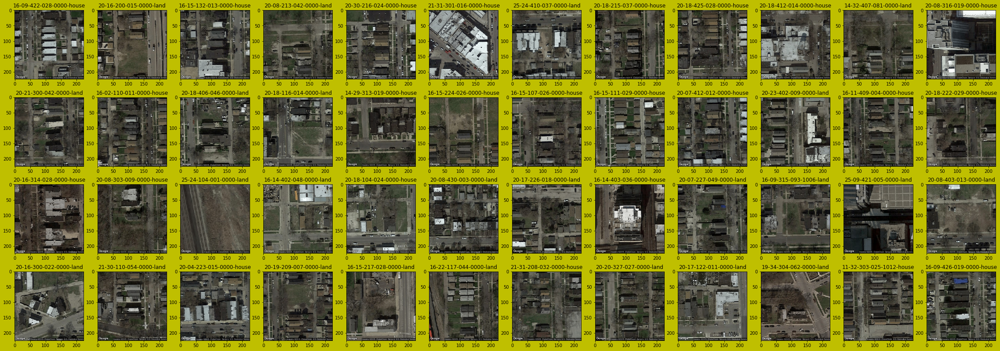

In [32]:
pin_ind = [str(p)+"-"+str(y) for p,y in zip(aerial_pin, rand_aerialY)]
print (len(aerial_pin), pin_ind)
vizualize(aerial_img_arr, pin_ind, data_type='uint8', rows=4, columns=12, figsize=(40, 14))

#### Overlayed Images Central-Cropped at [224,224,3]

48 ['16-09-422-028-0000-house', '20-16-200-015-0000-land', '16-15-132-013-0000-house', '20-08-213-042-0000-land', '20-30-216-024-0000-house', '21-31-301-016-0000-house', '25-24-410-037-0000-land', '20-18-215-037-0000-house', '20-18-425-028-0000-house', '20-18-412-014-0000-house', '14-32-407-081-0000-land', '20-08-316-019-0000-house', '20-21-300-042-0000-land', '16-02-110-011-0000-house', '20-18-406-046-0000-land', '20-18-116-014-0000-land', '14-29-313-019-0000-house', '16-15-224-026-0000-house', '16-15-107-026-0000-house', '16-15-111-029-0000-house', '20-07-412-012-0000-house', '20-23-402-009-0000-land', '16-11-409-004-0000-house', '20-18-222-029-0000-house', '20-16-314-028-0000-house', '20-08-303-009-0000-house', '25-24-104-001-0000-land', '16-14-402-048-0000-land', '20-18-104-024-0000-house', '20-08-430-003-0000-land', '20-17-226-018-0000-land', '16-14-403-036-0000-house', '20-07-227-049-0000-land', '16-09-315-093-1006-land', '25-09-421-005-0000-land', '20-08-403-013-0000-land', '20-

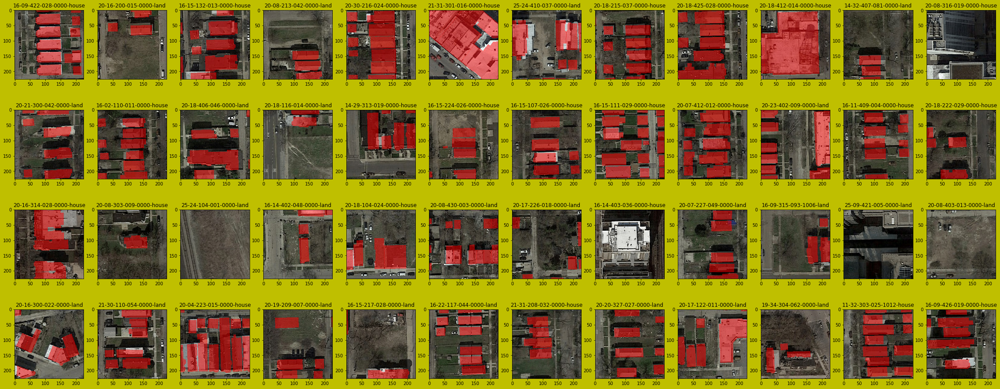

In [30]:
pin_ind = [str(p)+"-"+str(y) for p,y in zip(overlayed_pin, rand_overlayedY)]
print (len(overlayed_pin), pin_ind)
# for img in overlayed_img_arr:
#     
tf.reset_default_graph()
imgIN, imgOUT = crop_and_pad(inp_img_shape=[400,400,3], crop_img_shape=[224,224,3], out_img_shape=[224,224,3])
oberlayed_croppad_img_arr = []
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    for img in rand_overlayedX:
        oberlayed_croppad_img_arr.append(sess.run(imgOUT, feed_dict={imgIN:img}))
vizualize(oberlayed_croppad_img_arr, pin_ind, data_type='uint8', rows=4, columns=12, figsize=(40, 16))

#### Overlayed Crop [128,128,3]

48 ['16-09-422-028-0000-house', '20-16-200-015-0000-land', '16-15-132-013-0000-house', '20-08-213-042-0000-land', '20-30-216-024-0000-house', '21-31-301-016-0000-house', '25-24-410-037-0000-land', '20-18-215-037-0000-house', '20-18-425-028-0000-house', '20-18-412-014-0000-house', '14-32-407-081-0000-land', '20-08-316-019-0000-house', '20-21-300-042-0000-land', '16-02-110-011-0000-house', '20-18-406-046-0000-land', '20-18-116-014-0000-land', '14-29-313-019-0000-house', '16-15-224-026-0000-house', '16-15-107-026-0000-house', '16-15-111-029-0000-house', '20-07-412-012-0000-house', '20-23-402-009-0000-land', '16-11-409-004-0000-house', '20-18-222-029-0000-house', '20-16-314-028-0000-house', '20-08-303-009-0000-house', '25-24-104-001-0000-land', '16-14-402-048-0000-land', '20-18-104-024-0000-house', '20-08-430-003-0000-land', '20-17-226-018-0000-land', '16-14-403-036-0000-house', '20-07-227-049-0000-land', '16-09-315-093-1006-land', '25-09-421-005-0000-land', '20-08-403-013-0000-land', '20-

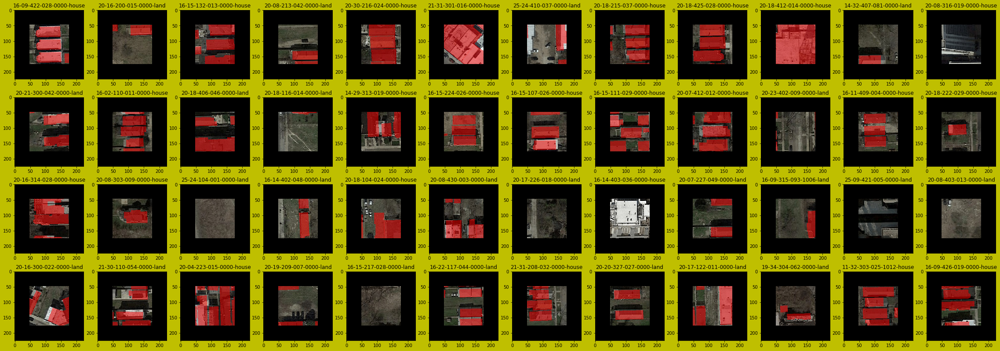

In [34]:
pin_ind = [str(p)+"-"+str(y) for p,y in zip(overlayed_pin, rand_overlayedY)]
print (len(overlayed_pin), pin_ind)
# for img in overlayed_img_arr:
#     
tf.reset_default_graph()
imgIN, imgOUT = crop_and_pad(inp_img_shape=[400,400,3], crop_img_shape=[128,128,3], out_img_shape=[224,224,3])
oberlayed_croppad_img_arr = []
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    for img in rand_overlayedX:
        oberlayed_croppad_img_arr.append(sess.run(imgOUT, feed_dict={imgIN:img}))
vizualize(oberlayed_croppad_img_arr, pin_ind, data_type='uint8', rows=4, columns=12, figsize=(40, 14))

#### Overlayed Crop [96,96,3]

48 ['16-09-422-028-0000-house', '20-16-200-015-0000-land', '16-15-132-013-0000-house', '20-08-213-042-0000-land', '20-30-216-024-0000-house', '21-31-301-016-0000-house', '25-24-410-037-0000-land', '20-18-215-037-0000-house', '20-18-425-028-0000-house', '20-18-412-014-0000-house', '14-32-407-081-0000-land', '20-08-316-019-0000-house', '20-21-300-042-0000-land', '16-02-110-011-0000-house', '20-18-406-046-0000-land', '20-18-116-014-0000-land', '14-29-313-019-0000-house', '16-15-224-026-0000-house', '16-15-107-026-0000-house', '16-15-111-029-0000-house', '20-07-412-012-0000-house', '20-23-402-009-0000-land', '16-11-409-004-0000-house', '20-18-222-029-0000-house', '20-16-314-028-0000-house', '20-08-303-009-0000-house', '25-24-104-001-0000-land', '16-14-402-048-0000-land', '20-18-104-024-0000-house', '20-08-430-003-0000-land', '20-17-226-018-0000-land', '16-14-403-036-0000-house', '20-07-227-049-0000-land', '16-09-315-093-1006-land', '25-09-421-005-0000-land', '20-08-403-013-0000-land', '20-

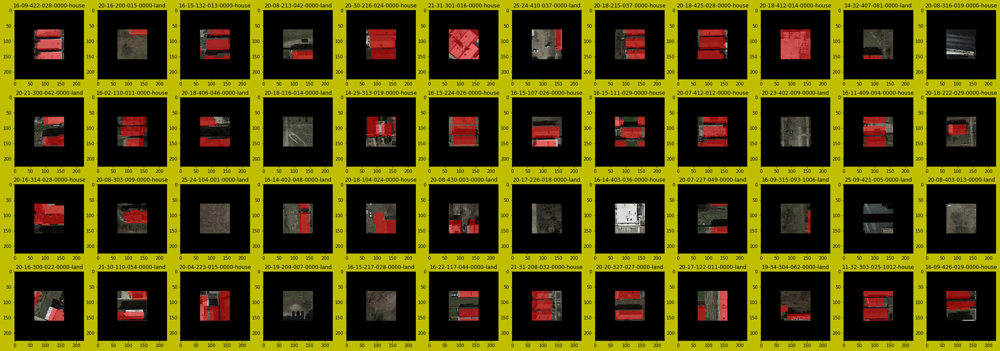

In [35]:
pin_ind = [str(p)+"-"+str(y) for p,y in zip(overlayed_pin, rand_overlayedY)]
print (len(overlayed_pin), pin_ind)
# for img in overlayed_img_arr:
#     
tf.reset_default_graph()
imgIN, imgOUT = crop_and_pad(inp_img_shape=[400,400,3], crop_img_shape=[96,96,3], out_img_shape=[224,224,3])
oberlayed_croppad_img_arr = []
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    for img in rand_overlayedX:
        oberlayed_croppad_img_arr.append(sess.run(imgOUT, feed_dict={imgIN:img}))
vizualize(oberlayed_croppad_img_arr, pin_ind, data_type='uint8', rows=4, columns=12, figsize=(40, 14))

In [107]:
import tensorflow as tf
import numpy as np
IMAGE_HEIGHT = 384
IMAGE_WIDTH = 384
IMAGE_CHANNELS = 3

def preprocessor(image):
    image = tf.reshape(image, (IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_CHANNELS))
    image = tf.image.central_crop(image,0.8)
    shape = tf.shape(image)
    return image,shape

image = tf.random_normal([IMAGE_HEIGHT,IMAGE_WIDTH,IMAGE_CHANNELS])
image_cropped,shape = preprocessor(image)

sess = tf.Session()
im_v,im_crop_v,shape_v = sess.run([image,image_cropped,shape])
print(im_v.shape)
print(im_crop_v.shape)
print(shape_v)

(384, 384, 3)
(308, 308, 3)
[308 308   3]


### GRAYSCALE

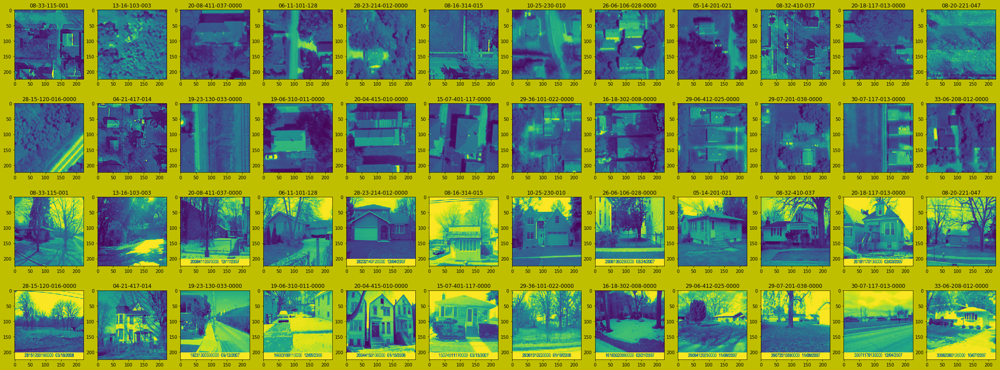

In [55]:
vizualize(gray, pins, data_type='float', rows=4, columns=12, figsize=(40, 15))

### IMAGE BLURR

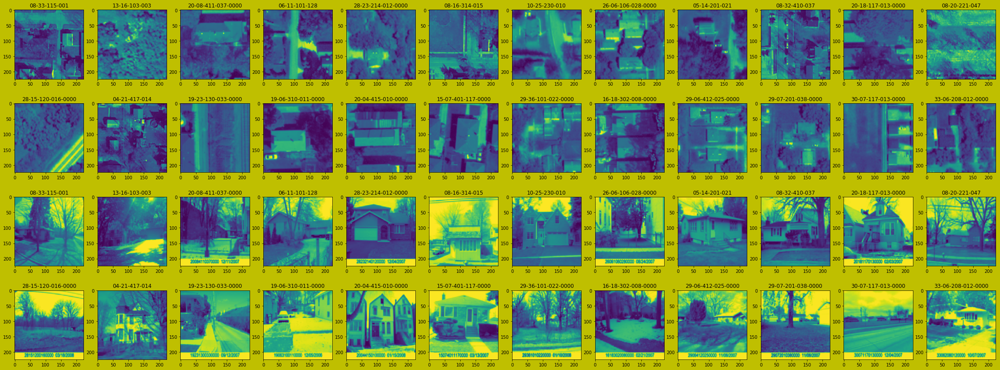

In [56]:
vizualize(blurr, pins, data_type='float', rows=4, columns=12, figsize=(40, 15))

### SOBEL EDGE

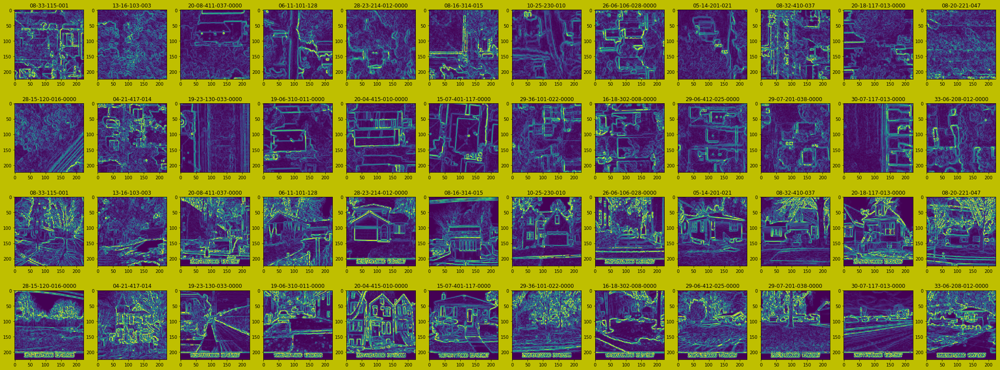

In [58]:
vizualize(sobel_edge, pins, data_type='float', rows=4, columns=12, figsize=(40, 15))

### AUTO CANNY EDGE

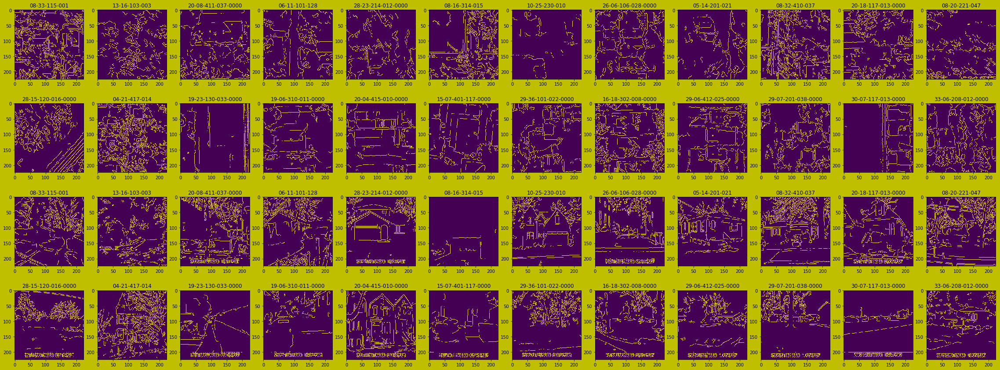

In [59]:
vizualize(canny_edge, pins, data_type='float', rows=4, columns=12, figsize=(40, 15))

### HOG FEATURE

/Users/sam/App-Setup/anaconda/envs/anaconda35/lib/python3.5/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


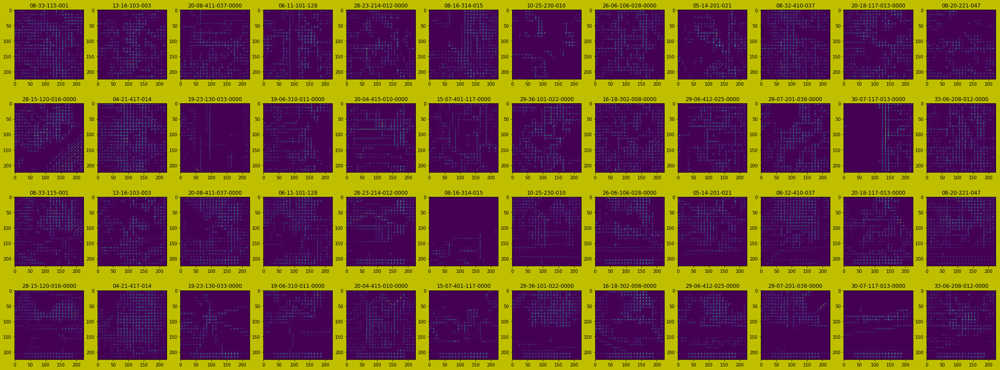

In [60]:
feature_params = dict(orientations=9, pixels_per_cell=(10, 10),
                            cells_per_block=(2, 2), vizualize=True, transform_sqrt=True)

hist_arr, hog_feature_arr = hog_feature(canny_edge, feature_params)
vizualize(hog_feature_arr, pins, data_type='float', rows=4, columns=12, figsize=(40, 15))

/Users/sam/App-Setup/anaconda/envs/anaconda35/lib/python3.5/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


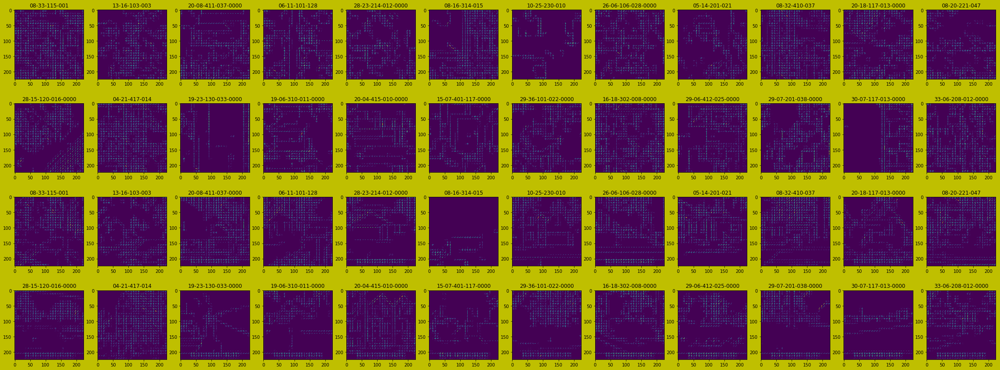

In [61]:
feature_params = dict(orientations=9, pixels_per_cell=(8, 8),
                            cells_per_block=(2, 2), vizualize=True, transform_sqrt=True)

hist_arr, hog_feature_arr = hog_feature(canny_edge, feature_params)
vizualize(hog_feature_arr, pins, data_type='float', rows=4, columns=12, figsize=(40, 15))

/Users/sam/App-Setup/anaconda/envs/anaconda35/lib/python3.5/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


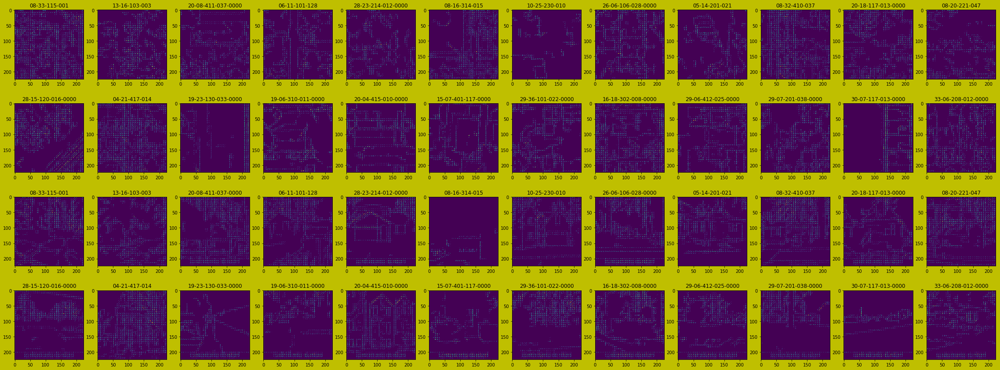

In [62]:
feature_params = dict(orientations=9, pixels_per_cell=(6, 6),
                            cells_per_block=(2, 2), vizualize=True, transform_sqrt=True)

hist_arr, hog_feature_arr = hog_feature(canny_edge, feature_params)
vizualize(hog_feature_arr, pins, data_type='float', rows=4, columns=12, figsize=(40, 15))

/Users/sam/App-Setup/anaconda/envs/anaconda35/lib/python3.5/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


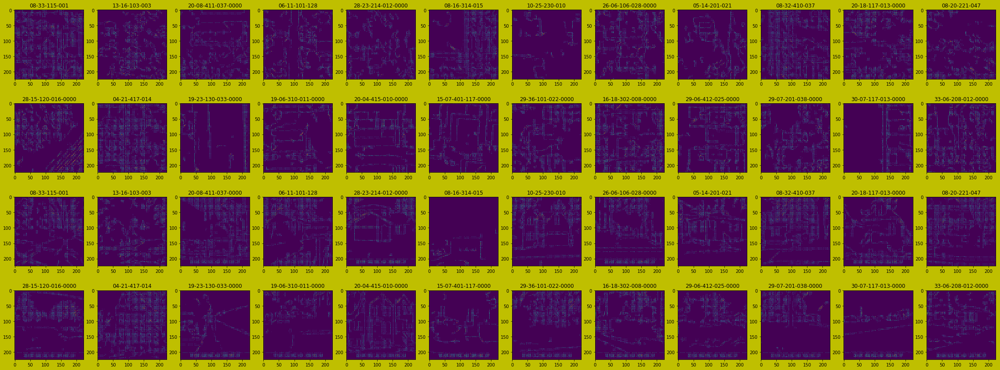

In [63]:
feature_params = dict(orientations=9, pixels_per_cell=(4, 4),
                            cells_per_block=(2, 2), vizualize=True, transform_sqrt=True)

hist_arr, hog_feature_arr = hog_feature(canny_edge, feature_params)
vizualize(hog_feature_arr, pins, data_type='float', rows=4, columns=12, figsize=(40, 15))

### HOUGH Tansform doesn't work as expected

In [ ]:
# https://www.geeksforgeeks.org/line-detection-python-opencv-houghline-method/
from copy import deepcopy
def hough_transform(edge_image, probabilistic=False):
    # The lines returns an array of r and theta value
    print(edge_image)
    # Below basically finds sinosoids(lines) in the hough space for each edge points in the Hough space
    if probabilistic:
        minLineLength = 100
        maxLineGap = 10
        lines = cv2.HoughLinesP(edge_image,1,np.pi/180,100,minLineLength,maxLineGap)
        # 1 denotes the accuracy of the d or (r) --> radians
        # np.pi/180 denotes the accuracy of the theta
        # 100 : min number of votes cast to a bin for it to be a line in image space
        # minLineLength, maxLineGap: parameters to sample a random subset of points from the edge_image_space
        # such that we dont do a lot of computation in find many many lines. For example suppose you have 10 points
        # alligned in a straight line, the lines can be even obtained using 2-3 points. So by considering only 2-3
        # lines we save a lot of computation and redundancy
        # Note the formula is d = xcos_theta - ysin_theta   this could result in negative values too, 
        # we have have lines pointing in the negative direction that might have received a lot of votes (200)
    else:
        print ('asdadasdasdas')
        i = 1
        min_votes = 70
        lines = None
        for i in range(0,10):
            print(min_votes, i)
            if lines==None:
                lines = cv2.HoughLines(edge_image,1, np.pi/180, min_votes)
                print (lines)
            else:
                break
            i+=1
            min_votes -= 5
        print (lines)
        # 1 denotes the accuracy of the d or (r) --> radians
        # np.pi/180 denotes the accuracy of the theta
        # 50 : min number of votes cast to a bin for it to be a line in image space
        # Note the formula is d = xcos_theta - ysin_theta   this could result in negative values too, 
        # we have have lines pointing in the negative direction that might have received a lot of votes (200)
#     print(lines)
    lines = lines.reshape(-1,lines.shape[2])
    print(lines.shape)
    for r,theta in lines:
        # Stores the value of cos(theta) in a
#         print(r, theta)
        a = np.cos(theta)
        
        # Stores the value of sin(theta) in b
        b = np.sin(theta)
        
        # x0 stores the value rcos(theta)
        x0 = a*r
        
        # y0 stores the value rsin(theta)
        y0 = b*r
        
        # x1 stores the rounded off value of (rcos(theta)-1000sin(theta)
        x1 = int(x0 + 1000*(-b))
        
        # y1 stores the rounded off value of (rsin(theta)+1000cos(theta))
        y1 = int(y0 + 1000*(a))
        
        # x2 stores the rounded off value of (rcos(theta)+1000sin(theta)
        x2 = int(x0 - 1000*(-b))

        # y2 stores the rounded off value of (rsin(theta)-1000cos(theta))
        y2 = int(y0 - 1000*(a))
        
        
        # cv2.line draws a line in img from the point(x1,y1) to (x2,y2).
        # (0,0,255) denotes the colour of the line to be 
        #drawn. In this case, it is red. 
        cv2.line(edge_image,(x1,y1), (x2,y2), (0,0,255),2)
        
    return edge_image


hough_image_arr = []
for edge_image in image_canny_edge_arr:
    print(edge_image.shape)
    hough_image = hough_transform(deepcopy(edge_image), probabilistic=False)
    hough_image_arr.append(hough_image)
#     break
#     print (hough_image_arr)
#     break

vizualize(hough_image_arr, rows=1, columns=5, figsize=(40, 6))